<a href="https://colab.research.google.com/github/Mercymerine/ML2_notes/blob/main/Data_Stories.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


# DATA STORY TELLING TYPES

## 1. Contrast

**Explanation:** Contrast storytelling focuses on comparing two or more datasets or groups to highlight differences or similarities. By juxtaposing data, you can clearly demonstrate how one variable or group performs in comparison to another, making it easier for the audience to understand the differences or identify significant patterns.

## 2. Zooming Out (Big Picture)
Explanation: Zooming out focuses on showing the broader context of the data. It involves looking at high-level trends, averages, or aggregate statistics that provide an overview of a situation.

##3. Drilling In (Deep Dive)
Explanation: Drilling in is the opposite of zooming out. It involves narrowing the focus to dive deeper into specific aspects or subsets of the data. This allows for more granular analysis, where specific trends, outliers, or anomalies can be highlighted.

##4. Trends Over Time
Explanation: This type of storytelling focuses on showing how data evolves or changes over a period of time. It’s useful for identifying patterns, seasonal variations, or long-term shifts in the data.

## 5. Factors and Outliers
Explanation: Factors and outliers storytelling is about identifying what influences certain outcomes.. This is important for understanding key drivers behind trends.
## 6. Intersection
Explanation: Intersection storytelling is about identifying where different variables or datasets overlap and how they interact. It’s useful when you need to explore relationships between two or more dimensions of data and understand how they influence each other.

## 7. Outliers
Explanation: Outliers storytelling focuses specifically on identifying and analyzing values that stand out from the rest of the data. Outliers can indicate unique events, errors, or extreme conditions, which can be critical in certain contexts.

# Drilling in (Deep Dive) illustration

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import folium
import geopandas as gpd
from shapely.geometry import Point

### Getting datasets

In [2]:
data = pd.read_csv('/content/earthquake_data (1).csv')
data.head()

,Date,Time,Latitude,Longitude,Type,Depth,Magnitude,Magnitude Type,geometry,Country,year,month,day,Continent
0,1965-01-12,13:32:25,27.357,87.867,Earthquake,20.0,5.9,MW,POINT (87.867 27.357),Nepal,1965.0,1.0,12.0,Asia
1,1965-01-17,20:57:41,-6.807,108.988,Earthquake,227.9,5.9,MW,POINT (108.988 -6.807),Indonesia,1965.0,1.0,17.0,Asia
2,1965-02-02,15:56:51,37.523,73.251,Earthquake,15.0,6.0,MW,POINT (73.251 37.523),Tajikistan,1965.0,2.0,2.0,Asia
3,1965-02-18,04:26:37,25.011,94.186,Earthquake,55.0,5.6,MW,POINT (94.186 25.011),India,1965.0,2.0,18.0,Asia
4,1965-02-23,22:11:47,-25.633,-70.679,Earthquake,35.0,7.0,MW,POINT (-70.679 -25.633),Chile,1965.0,2.0,23.0,South America


In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4889 entries, 0 to 4888
Data columns (total 14 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Date            4888 non-null   object 
 1   Time            4888 non-null   object 
 2   Latitude        4889 non-null   float64
 3   Longitude       4889 non-null   float64
 4   Type            4889 non-null   object 
 5   Depth           4889 non-null   float64
 6   Magnitude       4889 non-null   float64
 7   Magnitude Type  4889 non-null   object 
 8   geometry        4889 non-null   object 
 9   Country         4889 non-null   object 
 10  year            4888 non-null   float64
 11  month           4888 non-null   float64
 12  day             4888 non-null   float64
 13  Continent       4889 non-null   object 
dtypes: float64(7), object(7)
memory usage: 534.9+ KB


## Data Analysis
## Earthquakes
An earthquake is a sudden, rapid shaking of the ground caused by the shifting of rocks deep underneath the Earth's surface. This movement occurs along fault lines where tectonic plates meet. When the edges of faults stick together due to friction but the rest of the Earth's surface continues to move due to plate tectonics, pressure builds up. Eventually, this pressure is released in the form of energy called seismic waves, which travel through the Earth and cause the ground to shake.

In [4]:
import folium
from folium.plugins import MarkerCluster

In [5]:
m = folium.Map(location=[0, 0], zoom_start=2)



#Add marker clusters for each earthquake
marker_cluster = MarkerCluster().add_to(m)

#loop throught the dataframe and add each data point to mark the cluster
for idx, row in data.iterrows():
  folium.Marker(
      location=[row['Latitude'], row['Longitude']],
      popup=f'Country: {row["Country"]}<br>Magnitude: {row["Magnitude"]}',
      tooltip=f'{row["Country"]}, Magnitude: {row["Magnitude"]}, Year: {row["year"]}'
  ).add_to(marker_cluster)

display(m)




In [6]:
#Unique values in the coninent column
data['Continent'].unique()

array(['Asia', 'South America', 'Oceania', 'North America', 'Europe',
       'Africa', 'Antarctica'], dtype=object)

In [8]:
#Ranking continets based on the count of earthquakes that have happened
continents = data['Continent'].value_counts()
continents

,count
Continent,
Asia,2143
South America,1110
Oceania,619
North America,613
Europe,291
Africa,111
Antarctica,2


In [9]:
# A barplot to show the count of earthquakes in each continent using plotly

# Create bar chart (countplot)
country = continents.reset_index()
country.columns = ['Continent', 'Count']

fig = px.bar(country, x="Continent", y="Count",
             title="Earthquake Count by Continent",
             labels={"Count": "Number of Earthquakes", "Continent": "Continent"},
             color="Count",
             color_continuous_scale="Viridis")

# Improve layout
fig.update_layout(xaxis_tickangle=-45)  # Rotate x-axis labels
fig.update_traces(textposition="outside")  # Show counts on top

# Show figure
fig.show()




In [10]:
# Get the top continents with the most earthquakes (no need for value_counts again)
top_continents = data['Continent'].value_counts().index

# Filter the original DataFrame to include only data for the top continents
continent_df = data[data['Continent'].isin(top_continents)]

# Create the violin plot
fig = px.violin(continent_df,
                 x='Continent',
                 y='Magnitude',
                 box=True,  # Show box plot inside the violin
                 points='all',  # Show all data points
                 title='Earthquake Magnitude Distribution for Top Continents',
                 labels={'Continent': 'Continent', 'Magnitude': 'Magnitude', 'year': 'Year'})

# Customize the layout (optional)
fig.update_layout(xaxis_tickangle=-45)  # Rotate x-axis labels for better readability

# Show the plot
fig.show()

## Why earthquakes happen mostly around the ring of fire(Asia, South America, North America).


**Location:**
The Ring of Fire is a tectonic belt around the Pacific Ocean.

**Tectonic Plates:**
Intense tectonic activity involves multiple plates like the Antarctic, Nazca, Cocos, Pacific, and others.

**Seismic Activity:**
 Interactions create trenches, volcanic eruptions, and earthquake epicenters.

**Earthquake Concentration:**
Around 90% of the world's earthquakes occur in the Ring of Fire due to constant plate
.

The continuous movement and interaction of these plates are responsible for the high concentration of seismic activity.

## Why are earthquakes less frequent in Africa?

**Oceanic Borders:**

Most of the African plate's borders lie in the ocean, which dampens the effects of plate interactions that usually cause earthquakes.

**Plate Stability:**

 The African plate is relatively stable. It’s bounded by the oceanic crust of the Atlantic and Indian Oceans, which contributes to its overall stability and reduces the likelihood of major earthquakes.

# A dive into Africa

In [13]:
# Filtering out countries in african countries
africa = data[data['Continent'] == 'Africa']
africa

,Date,Time,Latitude,Longitude,Type,Depth,Magnitude,Magnitude Type,geometry,Country,year,month,day,Continent
82,1966-03-20,01:42:53,0.6220,29.8630,Earthquake,29.3,6.6,MW,POINT (29.863 0.622),Democratic Republic of the Congo,1966.0,3.0,20.0,Africa
137,1967-01-02,09:47:54,-10.1870,28.4240,Earthquake,29.1,5.6,MW,POINT (28.424 -10.187),Democratic Republic of the Congo,1967.0,1.0,2.0,Africa
221,1968-05-15,07:51:18,-15.8940,26.1130,Earthquake,25.7,5.6,MW,POINT (26.113 -15.894),Zambia,1968.0,5.0,15.0,Africa
259,1968-12-02,02:33:43,-14.1480,23.8770,Earthquake,11.3,5.7,MW,POINT (23.877 -14.148),Zambia,1968.0,12.0,2.0,Africa
277,1969-03-29,09:15:53,11.8750,41.2080,Earthquake,10.0,6.2,MW,POINT (41.208 11.875),Ethiopia,1969.0,3.0,29.0,Africa
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4583,2013-07-03,19:21:46,1.5370,30.8940,Earthquake,10.1,5.7,MW,POINT (30.894 1.537),Uganda,2013.0,7.0,3.0,Africa
4750,2015-08-07,01:25:03,-2.1412,28.8973,Earthquake,11.0,5.8,MW,POINT (28.8973 -2.1412),Democratic Republic of the Congo,2015.0,8.0,7.0,Africa
4751,2015-08-07,01:28:37,-2.0913,28.9515,Earthquake,10.0,5.5,MW,POINT (28.9515 -2.0913),Democratic Republic of the Congo,2015.0,8.0,7.0,Africa
4850,2016-09-10,12:27:33,-1.0355,31.6181,Earthquake,40.0,5.9,MW,POINT (31.6181 -1.0355),United Republic of Tanzania,2016.0,9.0,10.0,Africa


In [14]:
m_africa = folium.Map(location=[0, 20], zoom_start=3)  # Centered on Africa

marker_cluster = MarkerCluster().add_to(m_africa)

for idx, row in africa.iterrows():
    folium.Marker(
        location=[row['Latitude'], row['Longitude']],
        popup=f'Country: {row["Country"]}<br>Magnitude: {row["Magnitude"]}',
        tooltip=f'{row["Country"]}, Magnitude: {row["Magnitude"]}, Year: {row["year"]}'
    ).add_to(marker_cluster)

    display(m_africa)

In [15]:

# Group by country and count earthquakes
earthquake_counts = africa.groupby('Country')['Magnitude'].count().reset_index()

# Rename columns for clarity
earthquake_counts.columns = ['Country', 'EarthquakeCount']

# Sort by earthquake count in descending order
ranked_countries = earthquake_counts.sort_values(by=['EarthquakeCount'], ascending=False)

# Display the ranked countries
print(ranked_countries)

                             Country  EarthquakeCount
16       United Republic of Tanzania               18
1   Democratic Republic of the Congo               15
5                           Ethiopia               15
0                            Algeria               10
12                      South Africa                8
13                       South Sudan                6
9                             Malawi                6
2                           Djibouti                6
15                            Uganda                5
10                           Morocco                4
11                        Mozambique                4
17                            Zambia                4
8                         Madagascar                3
4                            Eritrea                2
3                              Egypt                2
7                             Guinea                1
6                              Gabon                1
14                          

In [16]:
import plotly.express as px

# Create the horizontal bar plot
fig = px.bar(ranked_countries,
             x='EarthquakeCount',
             y='Country',

             orientation='h',  # Set orientation to horizontal
             title='Rank of African Countries by Earthquake Frequency',
             labels={'EarthquakeCount': 'Number of Earthquakes', 'Country': 'Country'})

# Customize the layout (optional)
fig.update_layout(yaxis={'categoryorder': 'total ascending'})  # Order countries by rank

# Show the plot
fig.show()

**Key Areas with Fault Lines in Africa:**

**East African Rift System:**

    This is a major fault line where the African plate is splitting into two parts, creating a rift valley.

    Stretches from the Red Sea to Mozambique, including significant areas like the Afar Rift in Ethiopia and the Great Rift Valley in Kenya and Tanzania.

    Notable for creating earthquakes as the plate continues to split.

**North-West Africa:**

    Includes regions from Tunisia to Algeria and Mauritania.

    Significant earthquakes have occurred here, such as a 7.2 magnitude earthquake in 1980.

**Central Africa:**

    Features faults that span the volcanoes of Cameroon, Angola, Chad, and the Congo basin.

    This region also sees seismic activity, though less frequent.

**Southern Africa:**

    Comprises countries like Zimbabwe, Mozambique, Botswana, Zambia, Angola, Namibia, and South Africa.

In [17]:
#Scatterplot to show correlation between depth and magnitude especaally in east africa because most the earthquakes happen due to the rift valley
fig = px.scatter(africa,
                 x='Depth',
                 y='Magnitude',
                 title='Earthquake Depth vs. Magnitude in Africa',
                 labels={'Depth': 'Depth (km)', 'Magnitude': 'Magnitude'},
                 hover_data=['Country', 'year'],  # Add more columns for hover info if desired
                 trendline='ols'  # Add a trendline (optional)
                )

fig.show()


Correlation vs. Causation: Remember that correlation does not imply causation. Even if there is a correlation between depth and magnitude, it doesn't necessarily mean one directly causes the other.

In [18]:
#Bar Graph to show the types o f erthquakes ocuuring in Africa
# Get the earthquake types and their counts
earthquake_types = africa['Type'].value_counts()

# Create the bar graph
fig = px.bar(x=earthquake_types.index,
             y=earthquake_types.values,
             title='Types of Earthquakes in Africa',
             labels={'x': 'Earthquake Type', 'y': 'Count'})

# Show the graph
fig.show()


In [19]:
#Distribution of earthquake magnitudes in Africa
fig = px.histogram(africa,
                   x="Magnitude",
                   nbins=20,  # Adjust the number of bins as needed
                   title="Distribution of Earthquake Magnitudes in Africa",
                   labels={'Magnitude': 'Magnitude'})
fig.show()

In [20]:
# Sort by magnitude in descending order
ranked_africa = africa.sort_values(by=['Magnitude'], ascending=False)

# Add a rank column based on magnitude
ranked_africa['Magnitude_Rank'] = ranked_africa['Magnitude'].rank(ascending=False, method='dense')

# Display the ranked data
#print(ranked_africa[['Country', 'Magnitude', 'Magnitude_Rank', 'year', 'month']])
ranked_africa.head(20)

,Date,Time,Latitude,Longitude,Type,Depth,Magnitude,Magnitude Type,geometry,Country,year,month,day,Continent,Magnitude_Rank
1310,1980-10-10,12:25:24,36.195,1.354,Earthquake,10.0,7.3,MS,POINT (1.354 36.195),Algeria,1980.0,10.0,10.0,Africa,1.0
2256,1990-05-20,02:22:02,5.121,32.145,Earthquake,14.9,7.2,MW,POINT (32.145 5.121),South Sudan,1990.0,5.0,20.0,Africa,2.0
2258,1990-05-24,20:00:08,5.358,31.848,Earthquake,16.0,7.1,MW,POINT (31.848 5.358),South Sudan,1990.0,5.0,24.0,Africa,3.0
3818,2006-02-22,22:19:08,-21.324,33.583,Earthquake,11.0,7.0,MW,POINT (33.583 -21.324),Mozambique,2006.0,2.0,22.0,Africa,4.0
3807,2005-12-05,12:19:57,-6.224,29.830,Earthquake,22.0,6.8,MW,POINT (29.83 -6.224),United Republic of Tanzania,2005.0,12.0,5.0,Africa,5.0
2281,1990-07-09,15:11:20,5.395,31.654,Earthquake,12.6,6.6,MW,POINT (31.654 5.395),South Sudan,1990.0,7.0,9.0,Africa,6.0
82,1966-03-20,01:42:53,0.622,29.863,Earthquake,29.3,6.6,MW,POINT (29.863 0.622),Democratic Republic of the Congo,1966.0,3.0,20.0,Africa,6.0
3306,2000-10-02,02:25:31,-7.977,30.709,Earthquake,34.0,6.5,MW,POINT (30.709 -7.977),United Republic of Tanzania,2000.0,10.0,2.0,Africa,7.0
2257,1990-05-24,19:34:44,5.277,31.829,Earthquake,16.5,6.5,MW,POINT (31.829 5.277),South Sudan,1990.0,5.0,24.0,Africa,7.0
2162,1989-08-20,11:16:57,11.766,41.942,Earthquake,11.6,6.5,MW,POINT (41.942 11.766),Djibouti,1989.0,8.0,20.0,Africa,7.0


## South Sudan
### Zooming into the western rift valley/ Albertine rift

The Albertine Rift Valley, also known as Africa's Western Rift Valley, is a biodiverse region in East Africa. It spans parts of Uganda, the Democratic Republic of Congo, Rwanda, Burundi, and Tanzania, stretching from Lake Albert in the north to Lake Tanganyika in the south. The valley is formed by tectonic movements that are gradually separating the Somali Plate from the rest of the African continent.

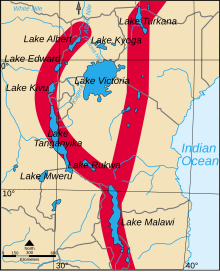

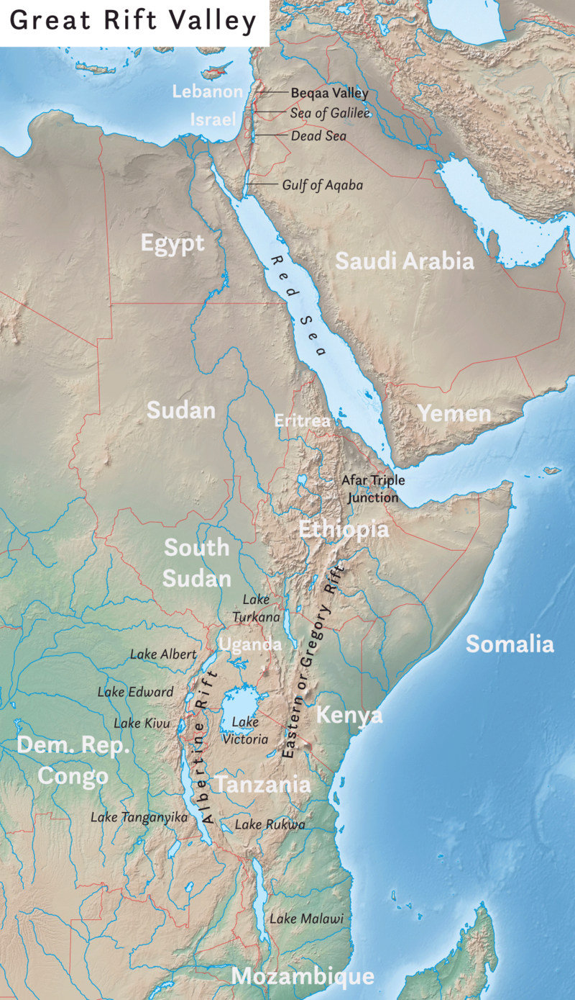

In [21]:
#Filter out data based on south africa only
sudan= data[data['Country'] == 'South Sudan']
sudan

,Date,Time,Latitude,Longitude,Type,Depth,Magnitude,Magnitude Type,geometry,Country,year,month,day,Continent
2256,1990-05-20,02:22:02,5.121,32.145,Earthquake,14.9,7.2,MW,POINT (32.145 5.121),South Sudan,1990.0,5.0,20.0,Africa
2257,1990-05-24,19:34:44,5.277,31.829,Earthquake,16.5,6.5,MW,POINT (31.829 5.277),South Sudan,1990.0,5.0,24.0,Africa
2258,1990-05-24,20:00:08,5.358,31.848,Earthquake,16.0,7.1,MW,POINT (31.848 5.358),South Sudan,1990.0,5.0,24.0,Africa
2259,1990-05-24,22:16:03,5.436,31.876,Earthquake,10.0,5.5,Other,POINT (31.876 5.436),South Sudan,1990.0,5.0,24.0,Africa
2281,1990-07-09,15:11:20,5.395,31.654,Earthquake,12.6,6.6,MW,POINT (31.654 5.395),South Sudan,1990.0,7.0,9.0,Africa
2305,1990-09-07,00:12:26,5.443,31.686,Earthquake,10.0,5.6,MW,POINT (31.686 5.443),South Sudan,1990.0,9.0,7.0,Africa


In [22]:
#A line graph to show trend of eathquake  in south africa

# Create line graph
fig = px.line(sudan,
              x='month',
              y='Magnitude',
              title='Earthquake Trend in South Sudan in 1990',
              labels={'year': 'Year', 'Magnitude': 'Magnitude'})

# Customize for better visualization (optional)
fig.update_traces(mode='markers+lines')  # Show markers and lines

# Show the graph
fig.show()

### Summary of the 1990 South Sudan Earthquakes Timeline:

**1990-05-20 02:22:02:**

The first and largest earthquake struck near Juba with a magnitude of 7.2, causing significant damage and resulting in 31 deaths.

**1990-05-24 19:34:44:**

A large earthquake occurred in southern South Sudan with a magnitude of 6.1-6.8, followed by an even stronger quake just over 25 minutes later.

**1990-05-24 20:00:08:**

The second strongest earthquake in the sequence hit with a magnitude of 7.0-7.1, causing additional structural damage.

**1990-05-24 22:16:03:**

Likely refers to another significant earthquake or aftershock on the same day as the previous two earthquakes.

**1990-07-09 15:11:20:**

Marks the end of the earthquake sequence, which included some of the largest recorded earthquakes in Africa.

**1990-09-07 00:12:26:**

Possibly another earthquake or aftershock after the main sequence had finished, but its significance is unclear.